<a href="https://colab.research.google.com/github/alecmeade/cs242_final_alec_daniel/blob/master/video_compression_model_trainer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
#@title Imports 
import tensorflow as tf
from tensorflow import keras
import numpy as np
import os
from enum import Enum
import glob
import math
from skimage import io
from skimage.transform import rescale
import matplotlib.pyplot as plt
from keras.applications.vgg16 import VGG16

In [74]:
#@title Mount the Google Drive
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [0]:
#@title Data Ingest functions

def DownloadVideoDatasets(kaggle_dir= "/content/gdrive/My Drive/Kaggle",

                          data_dir="/content/gdrive/My Drive/Kaggle/Datasets"):
  """Download all video datasets from Kaggle. This takes a long time and should
  only be run once."""
  # This is the google drive path where the kaggle.json API Key is stored.
  os.environ['KAGGLE_CONFIG_DIR'] = kaggle_dir

  #changing the working directory
  %cd $kaggle_dir

  # Try to create a directory for storing Kaggle data.
  os.makedirs(data_dir, exist_ok=True)

  # Download CS242-Final Dataset from Kaggle.
  !kaggle datasets download -d alecmeade/cs242-final -p '$data_dir'

  # Move to newly created dataset directory.
  %cd $data_dir

  # Unzipping the zip files and deleting the zip files.
  !unzip \*.zip  && rm *.zip

class VideoId(Enum):
  BEAUTY       = 0,
  HONEY_BEE    = 1,
  NATURE       = 2,
  READY_SET_GO = 3,
  SHAKE_N_DRY  = 4,
  YACHT        = 5

 

#Return a set of frames scaled to be 2048x1024
def GetFrames(video_id, num_frames,
              data_dir="/content/gdrive/My Drive/Kaggle/Datasets"):
  video_dir = ""
  if video_id == VideoId.BEAUTY:
    video_dir = "Beauty"
  elif video_id == VideoId.HONEY_BEE:
    video_dir = "HoneyBee"
  elif video_id == VideoId.NATURE:
    video_dir = "Nature"
  elif video_id == VideoId.READY_SET_GO:
    video_dir = "ReadySetGo"
  elif video_id == VideoId.SHAKE_N_DRY:
    video_dir = "ShakeNDry"
  elif video_id == VideoId.YACHT:
    video_dir = "Yacht"
  assert video_dir != ""
 
  frame_dir = data_dir + "/" + video_dir + "/" + video_dir
  files = glob.glob(frame_dir + "/*")
  print(os.listdir(frame_dir))
  print(len(files))
  files.sort()

  width = 2048
  height = 1024
  output_images = []
  for i in range(num_frames):
    image = io.imread(files[i]).astype(float) / 255.0
    output_images.append(
        rescale(image, (height/image.shape[0], width/image.shape[1], 1)))
  return np.array(output_images)

#Return a set of frames scaled to be 1080x1920
def GetFrames(video_id, num_frames):
  #Replace this with kaggle instead of google drive calls
  files = glob.glob("gdrive/My Drive/tf_video/Uncompressed Frames/" + video_id + "/*")
  files.sort()

  width = 2048
  height = 1024

  output_images = []
  for i in range(num_frames):
    image = io.imread(files[i]).astype(float) / 255.0
    output_images.append(
        rescale(image, (height/image.shape[0], width/image.shape[1], 1)))
  return np.array(output_images)


In [0]:
#@title Output Model functions

def SaveModelAndData(name, model, input_tensor, output_tensor):
  '''
  name: Destination to save the model
  model: A tensorflow model that will be saved out
  input_tensor: The tensor that is meant to be input to the model to produce the
  final images
  output_tensor: The golden frames that the model is attempting to predict
  '''
  directory = "gdrive/My Drive/tf_video/" + name
  #os.mkdir(directory)
  tf.keras.models.save_model(model, directory + "/model", include_optimizer=False)
  np.save(directory + "/input.npy", np.array(input_tensor))
  np.save(directory + "/output.npy", np.array(output_tensor))

In [0]:
#@title Error Functions

#Calculate the psnr error between the golden frames and the predicted frames.
def EvaluatePSNR(golden_frames, predicted_frames):
  '''
  golden_frames: A tf.tensor representing the set of original sequential frames.
  predicted_frames: A tf.tensor reprsenting the set of predicted frames. 

  return: The psnr between the two transformed in some way to fit with the 
  understanding of error.
  '''
  psnr = tf.image.psnr(golden_frames, predicted_frames, max_val=1.0)
  return 50 - psnr

#Calculate the ssim error between the golden frames and the predicted frames.
def EvaluateSSIM(golden_frames, predicted_frames):
  '''
  golden_frames: A tf.tensor representing the set of original sequential frames.
  predicted_frames: A tf.tensor reprsenting the set of predicted frames. 

  return: The sse between the two transformed in some way to fit with the 
  understanding of error.
  '''
  ssim = tf.image.ssim(golden_frames, predicted_frames, max_val=1)
  return 1 - ssim

#Load the vgg model outside of the function so that you do not need to load it
#everytime. If there is a way to define a static variable in python I will use 
#that instead.
vgg_model = VGG16(include_top=False, weights='imagenet',input_shape=(1024,2048,3))
vgg_model.trainable = False

#Calculate the vgg error between the golden frames and the predicted frames.
def EvaluateVGG(golden_frame, predicted_frame):
  '''
  golden_frames: A tf.tensor representing the set of original sequential frames.
  predicted_frames: A tf.tensor reprsenting the set of predicted frames. 

  return: The vgg between the two transformed in some way to fit with the 
  understanding of error.
  '''

  num_images = 8
  diff_frames = None

  golden_output = vgg_model(golden_frame)
  predicted_output = vgg_model(predicted_frame)

  diff_frames = predicted_output - golden_output
  return tf.math.reduce_mean(tf.math.square(diff_frames))

In [0]:
#@title Network Building Functions

#Create a unet with no skip level connections. The number of filters is constent
#across the entire network.
def BuildClassicUnetModel(input_shape, depth, filter_size=3, convolutions_per_level=5):
  '''
  input_shape: The shape of the input frames added to the model
  depth: How many times to downsize the frames in the model
  filter_size: The size of each filter in the convolution
  convolutions_per_level: How many convolutions to have at each level

  return: A tuple that contains the full model and the encoder and decoder models
  '''
  input_layer = keras.layers.Input(shape=input_shape)

  # Make Encoder
  encoder_last_layer = input_layer
  filter_num = input_shape[2]
  for i in range(depth):
    for conv in range(convolutions_per_level):
      encoder_last_layer = keras.layers.Conv2D(filter_num, filter_size, padding='same', activation=tf.nn.relu)(encoder_last_layer)
  encoder_last_layer = keras.layers.MaxPool2D()(encoder_last_layer)
  # Add the last three convolutional layers
  for conv in range(convolutions_per_level):
    encoder_last_layer = keras.layers.Conv2D(filter_num, filter_size, padding='same', activation=tf.nn.relu)(encoder_last_layer)

  encoder_model = tf.keras.Model(input_layer, encoder_last_layer)

  # Make decoder
  decoder_input = keras.layers.Input(shape=encoder_last_layer.shape[1:])
  decoder_last_layer = keras.layers.Conv2DTranspose(filter_num, filter_size, padding='same', strides=2, activation=tf.nn.relu)(decoder_input)
  for conv in range(convolutions_per_level):
    decoder_last_layer = keras.layers.Conv2D(filter_num, filter_size, padding='same', activation=tf.nn.relu)(decoder_last_layer)

  for i in range(depth - 1):
    decoder_last_layer = keras.layers.Conv2DTranspose(filter_num, 9, padding='same', strides=2, activation=tf.nn.relu)(decoder_last_layer)
    for conv in range(convolutions_per_level):
      decoder_last_layer = keras.layers.Conv2D(filter_num, filter_size, padding='same', activation=tf.nn.relu)(decoder_last_layer)

  decoder_model = tf.keras.Model(decoder_input, decoder_last_layer)

  # Create the full model by putting both models into a single sequential one
  full_model = tf.keras.Sequential()
  full_model.add(encoder_model)
  full_model.add(decoder_model)
  return (full_model, encoder_model, decoder_model)

# Create a model that upsamples from a single numeric input into a full frame sizel
# The model should be trained to predict a frame based soley on frame numbers
def BuildFrameInputModel(output_shape, depth_per_level, filter_size=3):
  '''
  output_shape: The shape of the frames to predicted
  depth_per_level: How many convolutions to use per level
  filter_size: filter size for each convolutions

  return: return a tuple to match the other model building functions such that the first element
  is the full model. The second element is the encoder which in this case is None. and the third 
  element is decoder which in this case is just the full model 
  '''
  scale_steps = np.array([math.log2(output_shape[0]), math.log2(output_shape[1])])

  input_layer = keras.layers.Input(shape=(1,1,1))
  filter_num = output_shape[2]

  last_layer = input_layer
  #Add enough upscaleing levels to get to the size of the frames.
  for i in range(int(max(scale_steps))):
    layer_stride = (1 + int(scale_steps[0] > 0), 1 + int(scale_steps[1] > 0))
    scale_steps = scale_steps - 1
    last_layer = keras.layers.Conv2DTranspose(filter_num, 9, padding='same', strides=layer_stride, activation=tf.nn.relu)(last_layer)

    for j in range(depth_per_level):
      last_layer = keras.layers.Conv2D(filter_num, 9, padding='same', activation=tf.nn.relu)(last_layer)

  full_model = tf.keras.Model(input_layer, last_layer)
  return (full_model, None, full_model)

In [0]:
#@title Plot Input, Output Frames, and the diff
def PlotFrames(golden_frames, predicted_frames):
  '''
  golden_frames: The frames to be predicted
  predicted_frames: The frames output from the model
  '''
  frame_shape = golden_frames.shape
  num_images = int(frame_shape[0])
  fig, axes = plt.subplots(num_images, 3, figsize=(30, 30))
  for i in range(num_images):
    golden_image = golden_frames[i]
    axes[i, 0].imshow(golden_image)
    predicted_image = predicted_frames[i]
    axes[i, 1].imshow(predicted_image)
    diff_image = tf.math.abs(golden_image - predicted_image)
    axes[i, 2].imshow(diff_image)
  plt.tight_layout()
  plt.show()


In [0]:
#@title Train Model and Plot and Output Results
# Create plots of the results of training a model. Plot the loss and all other metrics
# of the model and plot the predicted frames of the model
def PlotTrainingLosses(history, loss_term):
  '''
  history: The history generated from training the model
  loss_term: A string representing which loss was used to train the model
  '''
  loss_labels = ["EvaluateVGG", "EvaluatePSNR", "EvaluateSSIM", "mean_squared_error"] 
  plot_labels = ["VGG", "PSNR", "SSIM", "MeanSquaredError"]
  fig, axes = plt.subplots(1, len(loss_labels), constrained_layout=True, figsize=(15,5))
  fig.suptitle("Model Trained With " + loss_term + " Loss")
  for i in range(len(loss_labels)):
    data_points = None
    if (plot_labels[i] == loss_term):
      data_points = history.history['loss']
    else:
      data_points = history.history[loss_labels[i]]

    # Convert PSNR and SSIM back to its correct format
    if plot_labels[i] == "PSNR":
      data_points = 50 - np.array(data_points)
    elif plot_labels[i] == "SSIM":
      data_points = 1 - np.array(data_points) 

    axes[i].plot(data_points)
    axes[i].set_xlabel("epochs")
    axes[i].set_ylabel(plot_labels[i])
    axes[i].set_title(plot_labels[i] + " v epoch")
  plt.show()

# Main function to train and evaluate a model for compression. Will create either one
# or multiple identical models and train them using all the error functions while also reporting
# all metrics.
def TrainAndPlot(data, model_function, depth, num_epochs, frame_num_input=False, train_all=False):
  '''
  data: input frames to be trained on
  model_function: Function that will be used to build the model.
  depth: model input variable to determine model specific variables
  num_epochs: number of epochs to train for
  frame_num_inputs: if true use frame numbers as inputs instead of the data
  train_all: if true train using all loss functions instead of just PSNR

  return: Returns the models from training with PSNR as the loss function 
  '''
  opt = keras.optimizers.Adam(lr=.0001)

  input_data = np.array(data)
  if frame_num_input:
    input_data = np.array(range(len(data))).reshape(len(data), 1, 1, 1)
  golden_data = np.array(data)

  print("Training PSNR")
  (psnr_model, psnr_encoder_model, psnr_decoder_model) = model_function(data[0].shape, depth)
  psnr_model.compile(optimizer=opt, loss=EvaluatePSNR, metrics=[EvaluateVGG, EvaluateSSIM, tf.losses.MeanSquaredError()])
  psnr_history = psnr_model.fit(input_data, golden_data, epochs=num_epochs, batch_size=1, verbose=2)
  if train_all:
    print("Training VGG")
    (vgg_model, vgg_encoder_model, vgg_decoder_model) = model_function(data[0].shape, depth)
    vgg_model = tf.keras.models.Model(vgg_encoder_in, vgg_decoder_out)
    vgg_model.compile(optimizer=opt, loss=EvaluateVGG, metrics=[EvaluatePSNR, EvaluateSSIM, tf.losses.MeanSquaredError()])
    vgg_history = vgg_model.fit(input_data, golden_data, epochs=num_epochs, batch_size=1, verbose=2)
  
    print("Training SSIM")
    (ssim_model, ssim_encoder_model, ssim_decoder_model) = model_function(data[0].shape, depth)
    ssim_model.compile(optimizer=opt, loss=EvaluateSSIM, metrics=[EvaluateVGG, EvaluatePSNR, tf.losses.MeanSquaredError()])
    ssim_history = ssim_model.fit(input_data, golden_data, epochs=num_epochs, batch_size=1, verbose=2)

    print("Training Mean Squared Loss")
    (msq_model, msq_encoder_model, msq_decoder_model) = model_function(data[0].shape, depth)
    msq_model.compile(optimizer=opt, loss=tf.losses.MeanSquaredError(), metrics=[EvaluateVGG, EvaluatePSNR, EvaluateSSIM])
    msq_history = msq_model.fit(input_data, golden_data, epochs=num_epochs, batch_size=1, verbose=2)
  
  PlotTrainingLosses(psnr_history, "PSNR")
  PlotFrames(golden_data, psnr_model.predict(input_data))
  
  if train_all:
    PlotTrainingLosses(vgg_history, "VGG")
    PlotFrames(golden_data, vgg_model.predict(input_data))

    PlotTrainingLosses(ssim_history, "SSIM")
    PlotFrames(golden_data, ssim_model.predict(input_data))

    PlotTrainingLosses(msq_history, "MeanSquaredError")
    PlotFrames(golden_data, msq_model.predict(input_data))

  return (psnr_model, psnr_encoder_model, psnr_decoder_model)

In [0]:
#@title Load the Input Frames
Beauty = GetFrames("Beauty", 8)
HoneyBee = GetFrames("HoneyBee", 8)
Nature = GetFrames("Nature", 8)
ReadySetGo = GetFrames("ReadySetGo", 8)
ShakeNDry = GetFrames("ShakeNDry", 8)
Yacht = GetFrames("Yacht", 8)

# uncomment to use Kaggle
#DownloadVideoDatasets()

Training PSNR
Epoch 1/1000
8/8 - 2s - loss: 38.6615 - EvaluateVGG: 0.0357 - EvaluateSSIM: 0.9936 - mean_squared_error: 0.0735
Epoch 2/1000
8/8 - 2s - loss: 38.6284 - EvaluateVGG: 0.0357 - EvaluateSSIM: 0.9850 - mean_squared_error: 0.0729
Epoch 3/1000
8/8 - 2s - loss: 38.5933 - EvaluateVGG: 0.0357 - EvaluateSSIM: 0.9757 - mean_squared_error: 0.0723
Epoch 4/1000
8/8 - 2s - loss: 38.5562 - EvaluateVGG: 0.0357 - EvaluateSSIM: 0.9659 - mean_squared_error: 0.0717
Epoch 5/1000
8/8 - 2s - loss: 38.5165 - EvaluateVGG: 0.0357 - EvaluateSSIM: 0.9555 - mean_squared_error: 0.0711
Epoch 6/1000
8/8 - 2s - loss: 38.4738 - EvaluateVGG: 0.0357 - EvaluateSSIM: 0.9444 - mean_squared_error: 0.0704
Epoch 7/1000
8/8 - 2s - loss: 38.4273 - EvaluateVGG: 0.0357 - EvaluateSSIM: 0.9325 - mean_squared_error: 0.0696
Epoch 8/1000
8/8 - 2s - loss: 38.3764 - EvaluateVGG: 0.0357 - EvaluateSSIM: 0.9194 - mean_squared_error: 0.0688
Epoch 9/1000
8/8 - 2s - loss: 38.3200 - EvaluateVGG: 0.0357 - EvaluateSSIM: 0.9052 - mean_

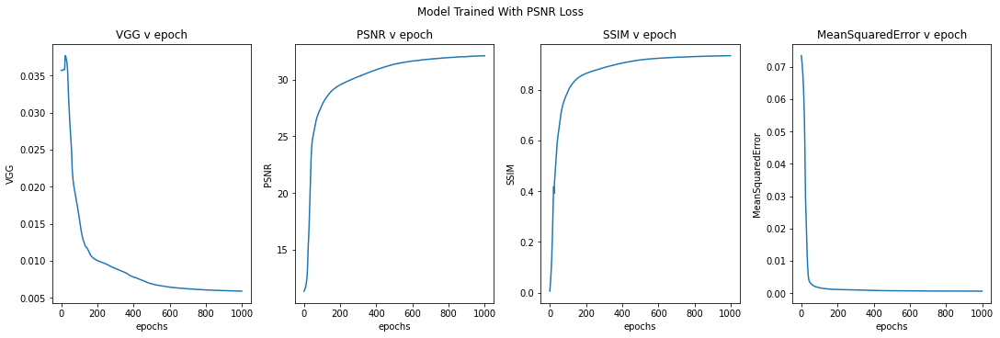

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


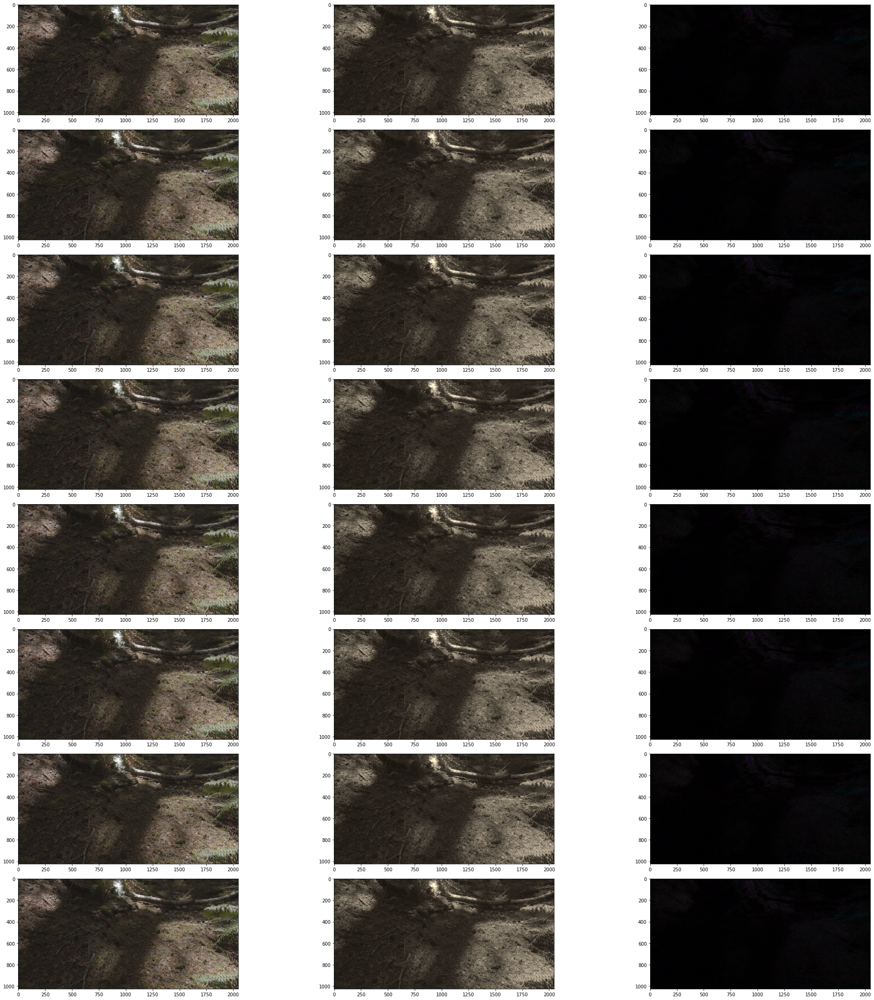

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: gdrive/My Drive/tf_video/Nature_Unet_1_PSNR/model/assets


In [0]:
(nature_psnr_model, nature_psnr_encoder, nature_psnr_decoder) = TrainAndPlot(Nature, BuildClassicUnetModel, 1, 1000)
nature_decoder_input = nature_psnr_encoder(np.array(Nature))
nature_output = nature_psnr_decoder(nature_decoder_input)
SaveModelAndData("Nature_Unet_1_PSNR", nature_psnr_decoder, nature_decoder_input, Nature)

Training PSNR
Epoch 1/1000
8/8 - 3s - loss: 38.6452 - EvaluateVGG: 0.0357 - EvaluateSSIM: 0.9904 - mean_squared_error: 0.0732
Epoch 2/1000
8/8 - 3s - loss: 38.5733 - EvaluateVGG: 0.0357 - EvaluateSSIM: 0.9738 - mean_squared_error: 0.0720
Epoch 3/1000
8/8 - 3s - loss: 38.4960 - EvaluateVGG: 0.0357 - EvaluateSSIM: 0.9561 - mean_squared_error: 0.0707
Epoch 4/1000
8/8 - 3s - loss: 38.4124 - EvaluateVGG: 0.0358 - EvaluateSSIM: 0.9373 - mean_squared_error: 0.0694
Epoch 5/1000
8/8 - 3s - loss: 38.3214 - EvaluateVGG: 0.0358 - EvaluateSSIM: 0.9176 - mean_squared_error: 0.0680
Epoch 6/1000
8/8 - 3s - loss: 38.2221 - EvaluateVGG: 0.0358 - EvaluateSSIM: 0.8967 - mean_squared_error: 0.0664
Epoch 7/1000
8/8 - 3s - loss: 38.1126 - EvaluateVGG: 0.0358 - EvaluateSSIM: 0.8752 - mean_squared_error: 0.0648
Epoch 8/1000
8/8 - 3s - loss: 37.9923 - EvaluateVGG: 0.0358 - EvaluateSSIM: 0.8531 - mean_squared_error: 0.0630
Epoch 9/1000
8/8 - 3s - loss: 37.8596 - EvaluateVGG: 0.0358 - EvaluateSSIM: 0.8309 - mean_

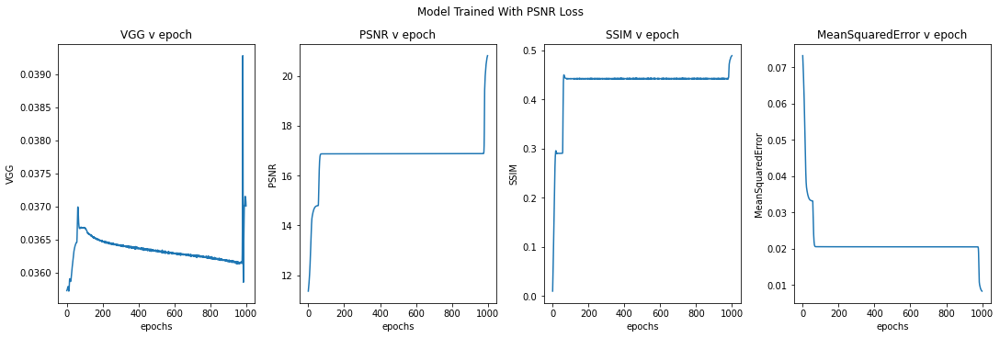

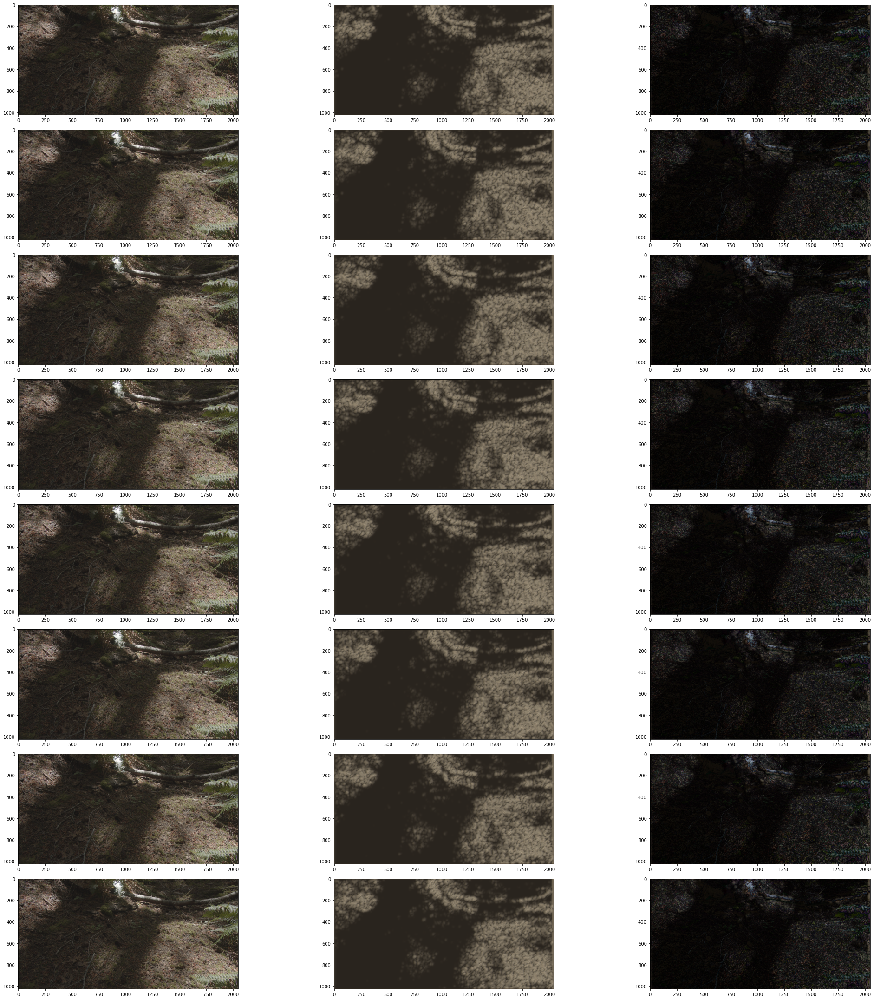

INFO:tensorflow:Assets written to: gdrive/My Drive/tf_video/Nature_Unet_2_PSNR/model/assets


In [0]:
(nature_psnr_model, nature_psnr_encoder, nature_psnr_decoder) = TrainAndPlot(Nature, BuildClassicUnetModel, 2, 1000)
nature_decoder_input = nature_psnr_encoder(np.array(Nature))
nature_output = nature_psnr_decoder(nature_decoder_input)
SaveModelAndData("Nature_Unet_2_PSNR", nature_psnr_decoder, nature_decoder_input, Nature)

Training PSNR
Epoch 1/1000
8/8 - 3s - loss: 38.6507 - EvaluateVGG: 0.0357 - EvaluateSSIM: 0.9910 - mean_squared_error: 0.0733
Epoch 2/1000
8/8 - 3s - loss: 38.5924 - EvaluateVGG: 0.0357 - EvaluateSSIM: 0.9757 - mean_squared_error: 0.0723
Epoch 3/1000
8/8 - 3s - loss: 38.5297 - EvaluateVGG: 0.0358 - EvaluateSSIM: 0.9595 - mean_squared_error: 0.0713
Epoch 4/1000
8/8 - 3s - loss: 38.4616 - EvaluateVGG: 0.0358 - EvaluateSSIM: 0.9422 - mean_squared_error: 0.0702
Epoch 5/1000
8/8 - 3s - loss: 38.3864 - EvaluateVGG: 0.0358 - EvaluateSSIM: 0.9241 - mean_squared_error: 0.0690
Epoch 6/1000
8/8 - 3s - loss: 38.3026 - EvaluateVGG: 0.0358 - EvaluateSSIM: 0.9052 - mean_squared_error: 0.0677
Epoch 7/1000
8/8 - 3s - loss: 38.2075 - EvaluateVGG: 0.0358 - EvaluateSSIM: 0.8862 - mean_squared_error: 0.0662
Epoch 8/1000
8/8 - 3s - loss: 38.0990 - EvaluateVGG: 0.0358 - EvaluateSSIM: 0.8680 - mean_squared_error: 0.0646
Epoch 9/1000
8/8 - 3s - loss: 37.9754 - EvaluateVGG: 0.0358 - EvaluateSSIM: 0.8518 - mean_

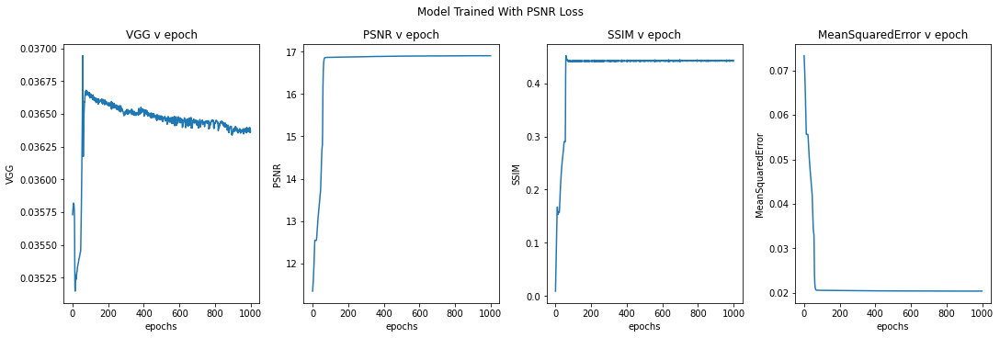

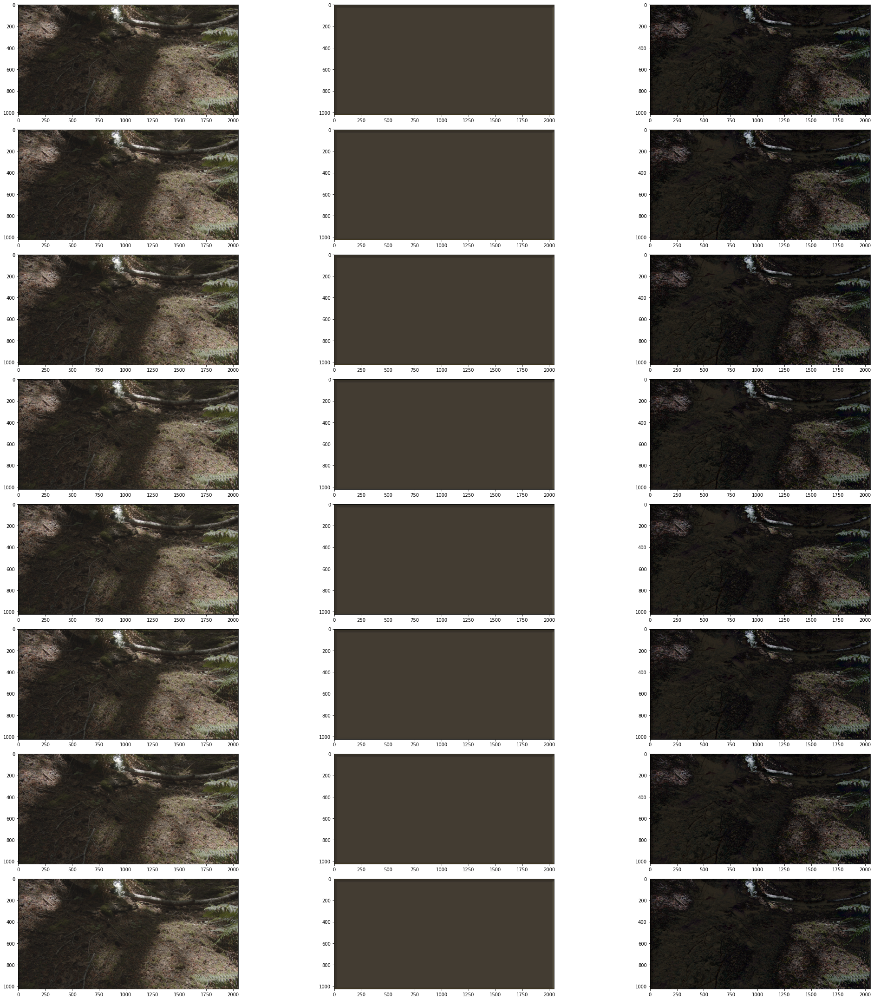

INFO:tensorflow:Assets written to: gdrive/My Drive/tf_video/Nature_Unet_3_PSNR/model/assets


In [0]:
(nature_psnr_model, nature_psnr_encoder, nature_psnr_decoder) = TrainAndPlot(Nature, BuildClassicUnetModel, 3, 1000)
nature_decoder_input = nature_psnr_encoder(np.array(Nature))
nature_output = nature_psnr_decoder(nature_decoder_input)
SaveModelAndData("Nature_Unet_3_PSNR", nature_psnr_decoder, nature_decoder_input, Nature)

Training PSNR
Epoch 1/1000
8/8 - 2s - loss: 41.7880 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9964 - mean_squared_error: 0.1509
Epoch 2/1000
8/8 - 2s - loss: 41.7691 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9909 - mean_squared_error: 0.1503
Epoch 3/1000
8/8 - 2s - loss: 41.7475 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9846 - mean_squared_error: 0.1495
Epoch 4/1000
8/8 - 2s - loss: 41.7238 - EvaluateVGG: 0.0324 - EvaluateSSIM: 0.9777 - mean_squared_error: 0.1487
Epoch 5/1000
8/8 - 2s - loss: 41.6976 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9701 - mean_squared_error: 0.1478
Epoch 6/1000
8/8 - 2s - loss: 41.6687 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9617 - mean_squared_error: 0.1468
Epoch 7/1000
8/8 - 2s - loss: 41.6363 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9524 - mean_squared_error: 0.1458
Epoch 8/1000
8/8 - 2s - loss: 41.6001 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9422 - mean_squared_error: 0.1445
Epoch 9/1000
8/8 - 2s - loss: 41.5595 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9311 - mean_

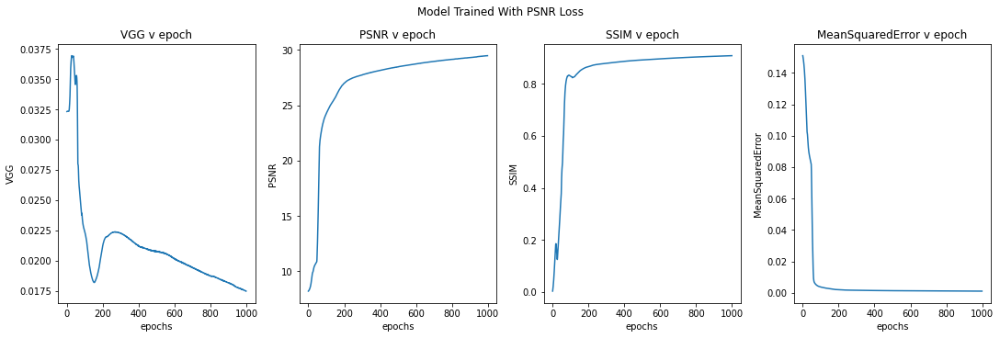

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [0]:
(Honey_psnr_model, Honey_psnr_encoder, Honey_psnr_decoder) = TrainAndPlot(HoneyBee, BuildClassicUnetModel, 1, 1000)
Honey_decoder_input = Honey_psnr_encoder(np.array(HoneyBee))
Honey_output = Honey_psnr_decoder(Honey_decoder_input)
SaveModelAndData("Honey_Unet_1_PSNR", Honey_psnr_decoder, Honey_decoder_input, HoneyBee)

In [0]:
(Honey_psnr_model, Honey_psnr_encoder, Honey_psnr_decoder) = TrainAndPlot(HoneyBee, BuildClassicUnetModel, 2, 1000)
Honey_decoder_input = Honey_psnr_encoder(np.array(HoneyBee))
Honey_output = Honey_psnr_decoder(Honey_decoder_input)
SaveModelAndData("Honey_Unet_2_PSNR", Honey_psnr_decoder, Honey_decoder_input, HoneyBee)

In [0]:
(Honey_psnr_model, Honey_psnr_encoder, Honey_psnr_decoder) = TrainAndPlot(HoneyBee, BuildClassicUnetModel, 3, 1000)
Honey_decoder_input = Honey_psnr_encoder(np.array(HoneyBee))
Honey_output = Honey_psnr_decoder(Honey_decoder_input)
SaveModelAndData("Honey_Unet_3_PSNR", Honey_psnr_decoder, Honey_decoder_input, HoneyBee)

In [0]:
(beauty_psnr_model, beauty_psnr_encoder, beauty_psnr_decoder) = TrainAndPlot(Beauty, BuildClassicUnetModel, 1, 1000)
beauty_decoder_input = beauty_psnr_encoder(np.array(Beauty))
beauty_output = beauty_psnr_decoder(beauty_decoder_input)
SaveModelAndData("Beauty_Unet_1_PSNR", beauty_psnr_decoder, beauty_decoder_input, Beauty)

In [0]:
(beauty_psnr_model, beauty_psnr_encoder, beauty_psnr_decoder) = TrainAndPlot(Beauty, BuildClassicUnetModel, 2, 1000)
beauty_decoder_input = beauty_psnr_encoder(np.array(Beauty))
beauty_output = beauty_psnr_decoder(beauty_decoder_input)
SaveModelAndData("Beauty_Unet_2_PSNR", beauty_psnr_decoder, beauty_decoder_input, Beauty)

In [0]:
(beauty_psnr_model, beauty_psnr_encoder, beauty_psnr_decoder) = TrainAndPlot(Beauty, BuildClassicUnetModel, 3, 1000)
beauty_decoder_input = beauty_psnr_encoder(np.array(Beauty))
beauty_output = beauty_psnr_decoder(beauty_decoder_input)
SaveModelAndData("Beauty_Unet_3_PSNR", beauty_psnr_decoder, beauty_decoder_input, Beauty)

In [0]:
TrainAndPlot(ReadySetGo, BuildClassicUnetModel, 2, 1000)

In [0]:
decoder_input = psnr_encoder(np.array(HonneyBee))
output = psnr_decoder(decoder_input)
SaveModelAndData("HoneyBeePSNR", psnr_decoder, decoder_input, HonneyBee)

INFO:tensorflow:Assets written to: gdrive/My Drive/tf_video/HoneyBeePSNR/model/assets


In [0]:
TrainAndPlot(Beauty, BuildFrameInputModel, 2, 1000, frame_num_input=True)

In [0]:
(psnr_encoder_in, psnr_encoder_out, psnr_decoder_in, psnr_decoder_out) = TrainAndPlot(HonneyBee, BuildFrameInputModel, 1, 250, frame_num_input=True)

In [0]:
(Honey_psnr_model, Honey_psnr_encoder, Honey_psnr_decoder) = TrainAndPlot(HonneyBee, BuildClassicUnetModel, 3, 1000)

Training PSNR
Epoch 1/1000
8/8 - 3s - loss: 41.7846 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9960 - mean_squared_error: 0.1508
Epoch 2/1000
8/8 - 3s - loss: 41.7562 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9894 - mean_squared_error: 0.1498
Epoch 3/1000
8/8 - 3s - loss: 41.7236 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9819 - mean_squared_error: 0.1487
Epoch 4/1000
8/8 - 3s - loss: 41.6870 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9734 - mean_squared_error: 0.1475
Epoch 5/1000
8/8 - 3s - loss: 41.6455 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9641 - mean_squared_error: 0.1461
Epoch 6/1000
8/8 - 3s - loss: 41.5981 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9536 - mean_squared_error: 0.1445
Epoch 7/1000
8/8 - 3s - loss: 41.5433 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9421 - mean_squared_error: 0.1427
Epoch 8/1000
8/8 - 3s - loss: 41.4798 - EvaluateVGG: 0.0322 - EvaluateSSIM: 0.9294 - mean_squared_error: 0.1406
Epoch 9/1000
8/8 - 3s - loss: 41.4056 - EvaluateVGG: 0.0322 - EvaluateSSIM: 0.9157 - mean_

KeyboardInterrupt: ignored

Training PSNR
Epoch 1/1000
8/8 - 2s - loss: 41.7845 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9949 - mean_squared_error: 0.1508
Epoch 2/1000
8/8 - 2s - loss: 41.7577 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9860 - mean_squared_error: 0.1499
Epoch 3/1000
8/8 - 2s - loss: 41.7286 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9762 - mean_squared_error: 0.1489
Epoch 4/1000
8/8 - 2s - loss: 41.6971 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9657 - mean_squared_error: 0.1478
Epoch 5/1000
8/8 - 2s - loss: 41.6628 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9543 - mean_squared_error: 0.1466
Epoch 6/1000
8/8 - 2s - loss: 41.6251 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9419 - mean_squared_error: 0.1454
Epoch 7/1000
8/8 - 2s - loss: 41.5834 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9282 - mean_squared_error: 0.1440
Epoch 8/1000
8/8 - 2s - loss: 41.5368 - EvaluateVGG: 0.0323 - EvaluateSSIM: 0.9132 - mean_squared_error: 0.1425
Epoch 9/1000
8/8 - 2s - loss: 41.4845 - EvaluateVGG: 0.0322 - EvaluateSSIM: 0.8966 - mean_

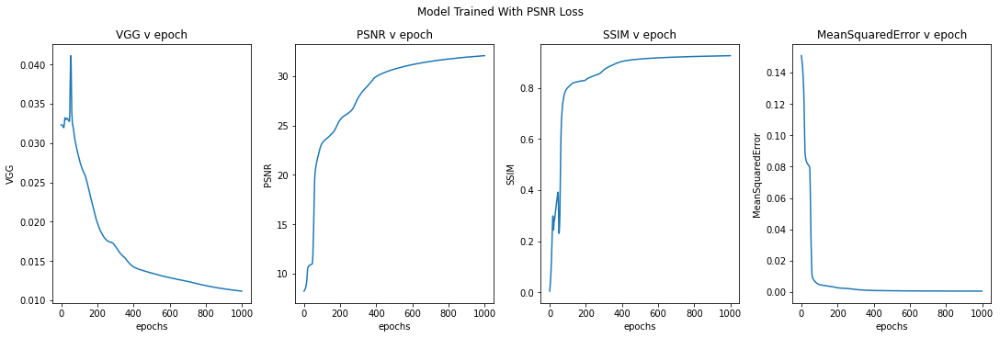

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


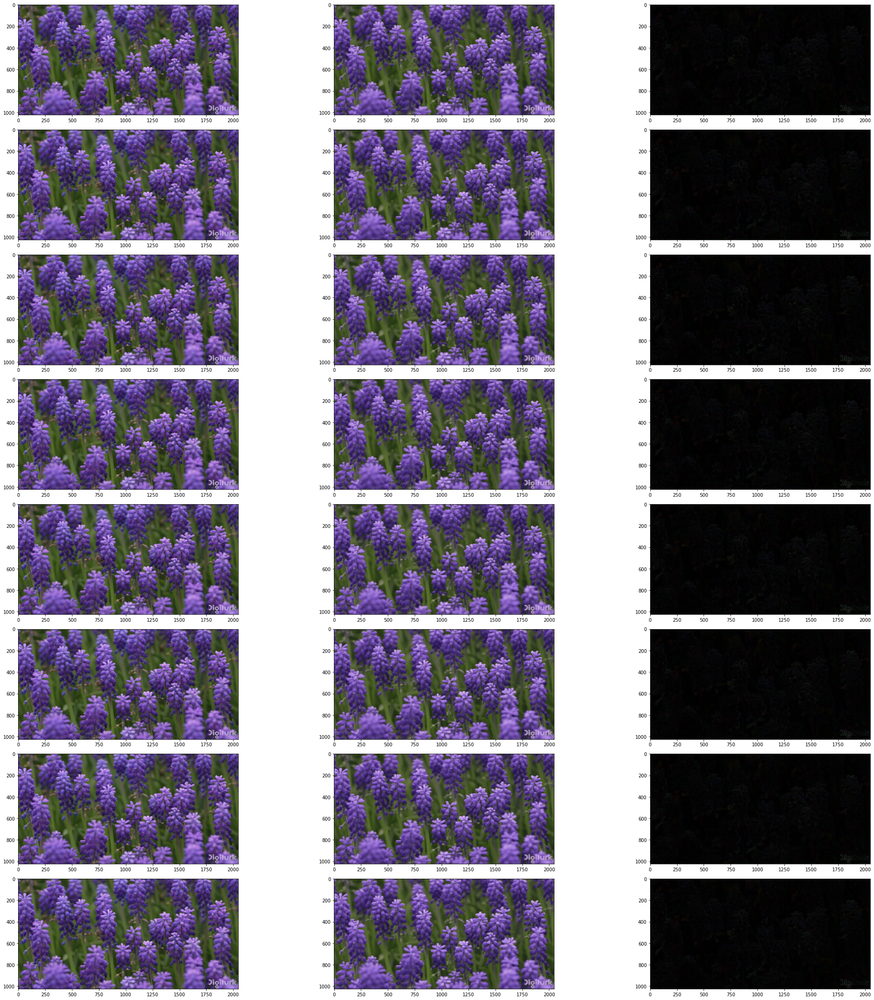

In [0]:
(Honey_psnr_model, Honey_psnr_encoder, Honey_psnr_decoder) = TrainAndPlot(HonneyBee, BuildClassicUnetModel, 2, 1000)

In [0]:
(HoneyBee_psnr_model_frames, temp1, temp2) = TrainAndPlot(HoneyBee, BuildFrameInputModel, 25, 1000, frame_num_input=True)
SaveModelAndData("HoneyBee_25_Frames", HoneyBee_psnr_model_frames, np.array(range(len(HoneyBee))).reshape(len(HoneyBee), 1, 1, 1), HoneyBee)

In [0]:
(nature_psnr_model_frames, temp1, temp2) = TrainAndPlot(ReadySetGo, BuildFrameInputModel, 25, 1000, frame_num_input=True)
SaveModelAndData("Nature_Unet_25_Frames", nature_psnr_model_frames, np.array(range(len(Nature))).reshape(len(Nature), 1, 1, 1), Nature)

In [0]:
TrainAndPlot(ShakeNDry, BuildFrameInputModel, 2, 1000, frame_num_input=True)

In [0]:
TrainAndPlot(ShakeNDry, BuildClassicUnetModel, 2, 1000)

In [0]:
TrainAndPlot(Yacht, BuildFrameInputModel, 2, 1000, frame_num_input=True)

In [0]:
TrainAndPlot(Yacht, BuildClassicUnetModel, 2, 1000)

In [0]:
data_image_array = nature.reshape(8, 1024, 2048, 3)
full_data_array = np.array(data_image_array)

Streaming output truncated to the last 5000 lines.
8/8 - 2s - loss: 18.2013 - EvaluateVGG: 0.0048 - EvaluateSSIM: 0.0438 - mean_squared_error: 6.6187e-04
Epoch 503/1000
8/8 - 2s - loss: 18.1974 - EvaluateVGG: 0.0048 - EvaluateSSIM: 0.0438 - mean_squared_error: 6.6125e-04
Epoch 504/1000
8/8 - 2s - loss: 18.1954 - EvaluateVGG: 0.0048 - EvaluateSSIM: 0.0438 - mean_squared_error: 6.6095e-04
Epoch 505/1000
8/8 - 2s - loss: 18.1987 - EvaluateVGG: 0.0048 - EvaluateSSIM: 0.0438 - mean_squared_error: 6.6144e-04
Epoch 506/1000
8/8 - 2s - loss: 18.1969 - EvaluateVGG: 0.0048 - EvaluateSSIM: 0.0437 - mean_squared_error: 6.6118e-04
Epoch 507/1000
8/8 - 2s - loss: 18.1942 - EvaluateVGG: 0.0048 - EvaluateSSIM: 0.0438 - mean_squared_error: 6.6076e-04
Epoch 508/1000
8/8 - 2s - loss: 18.1913 - EvaluateVGG: 0.0048 - EvaluateSSIM: 0.0437 - mean_squared_error: 6.6033e-04
Epoch 509/1000
8/8 - 2s - loss: 18.1922 - EvaluateVGG: 0.0048 - EvaluateSSIM: 0.0437 - mean_squared_error: 6.6046e-04
Epoch 510/1000
8/8 -

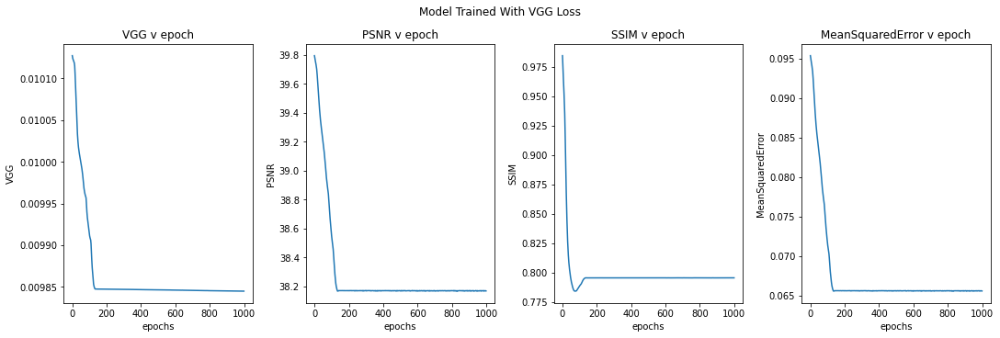

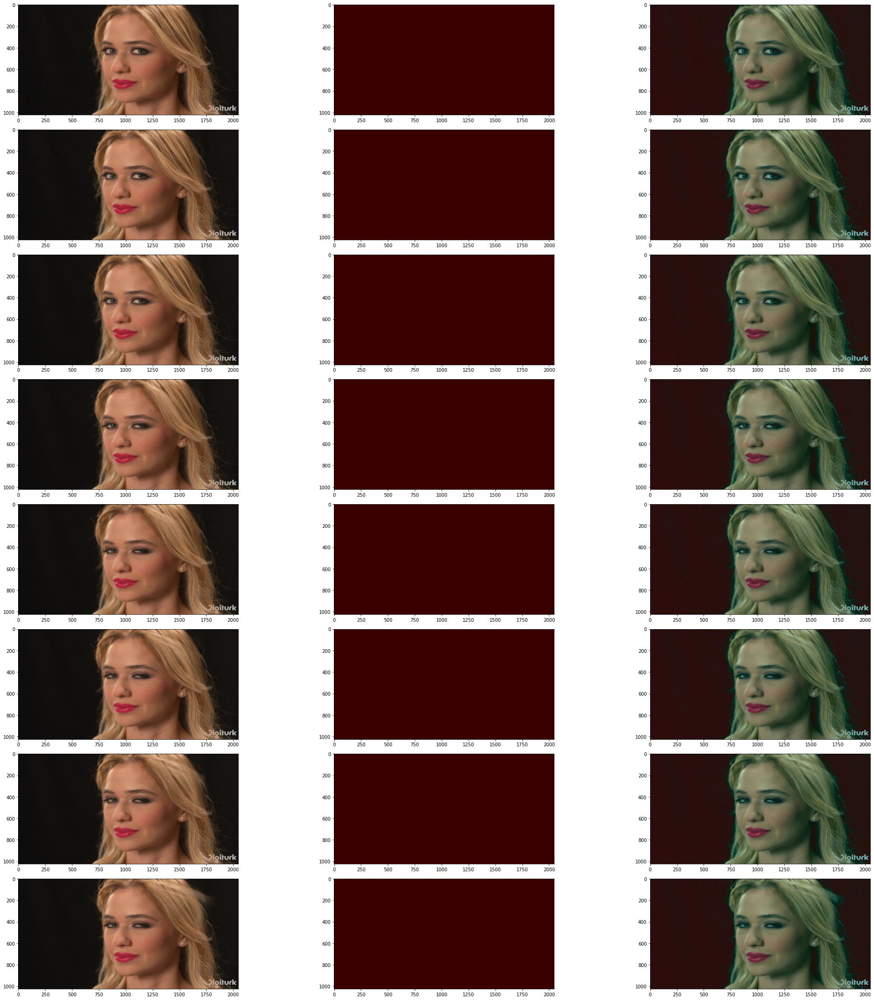

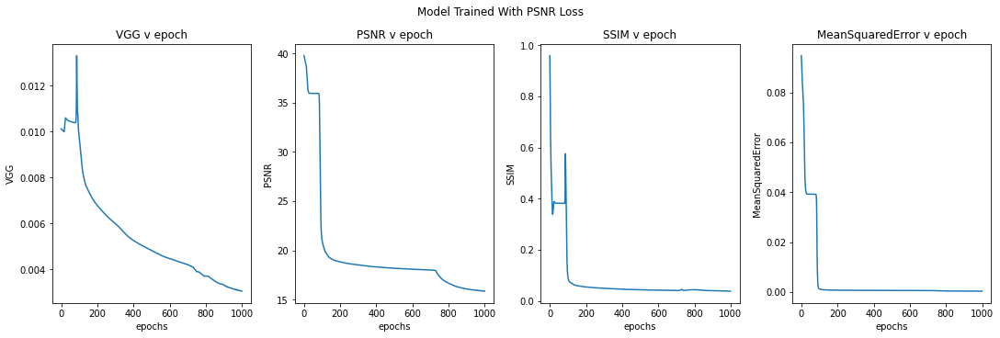

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


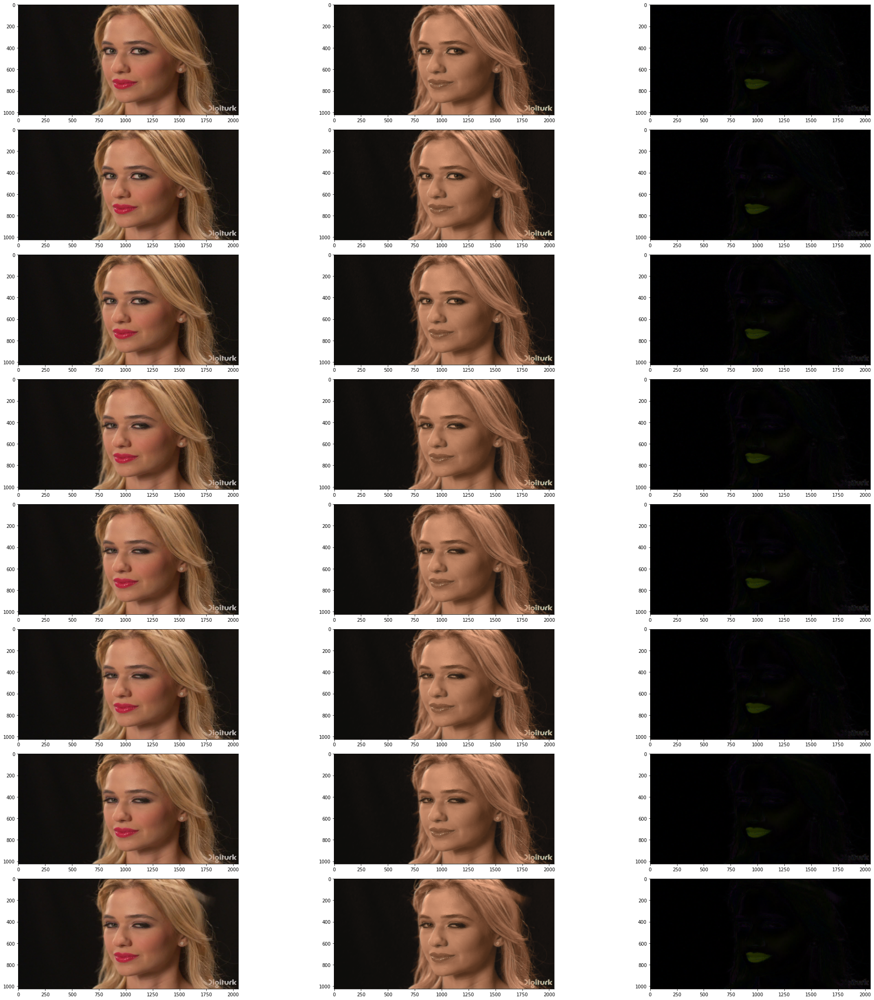

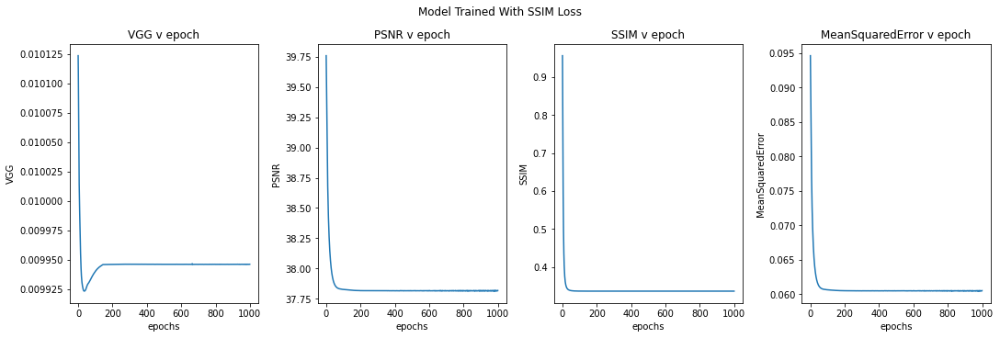

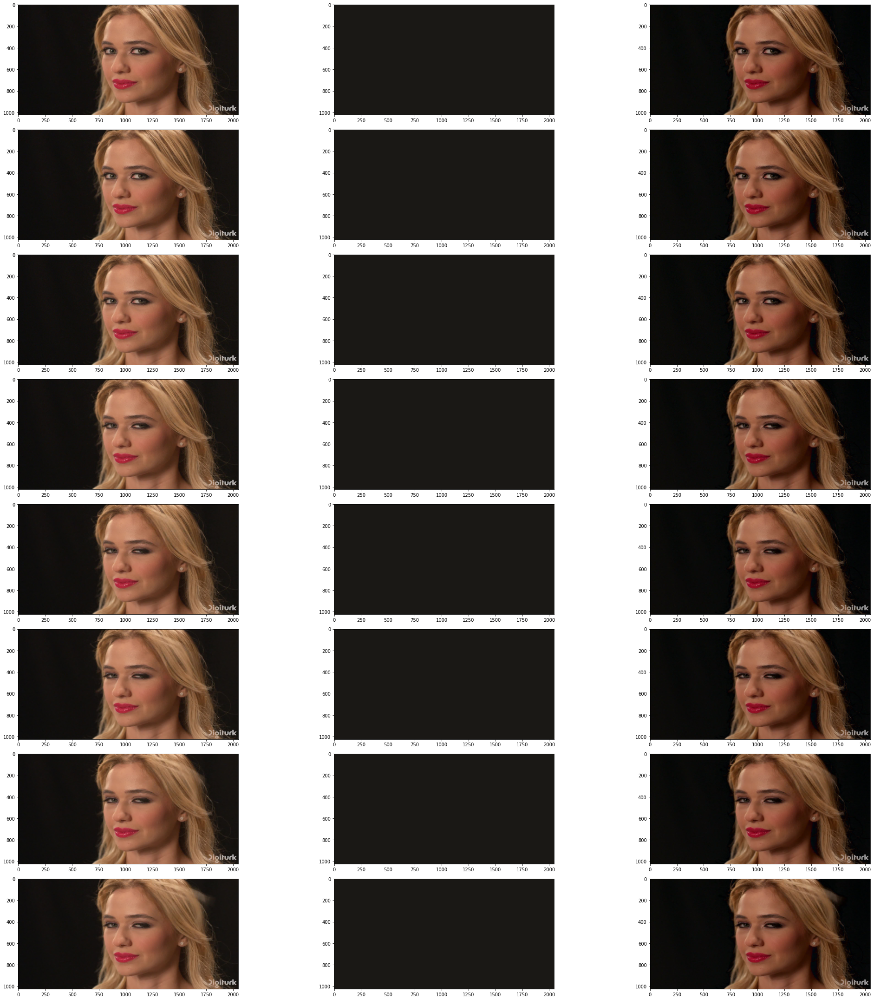

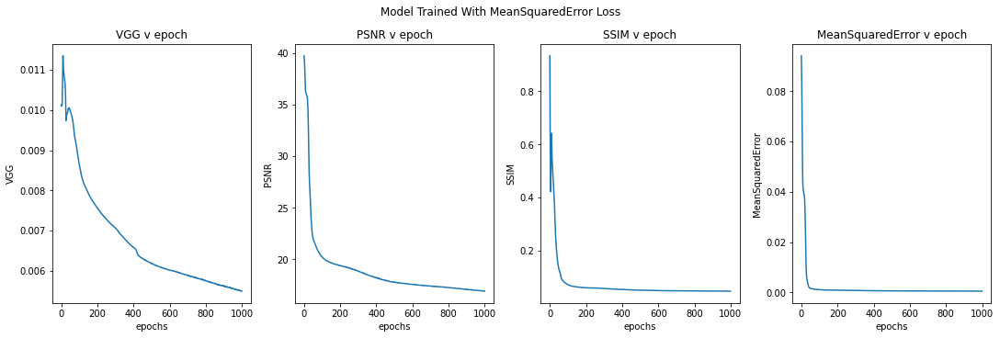

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


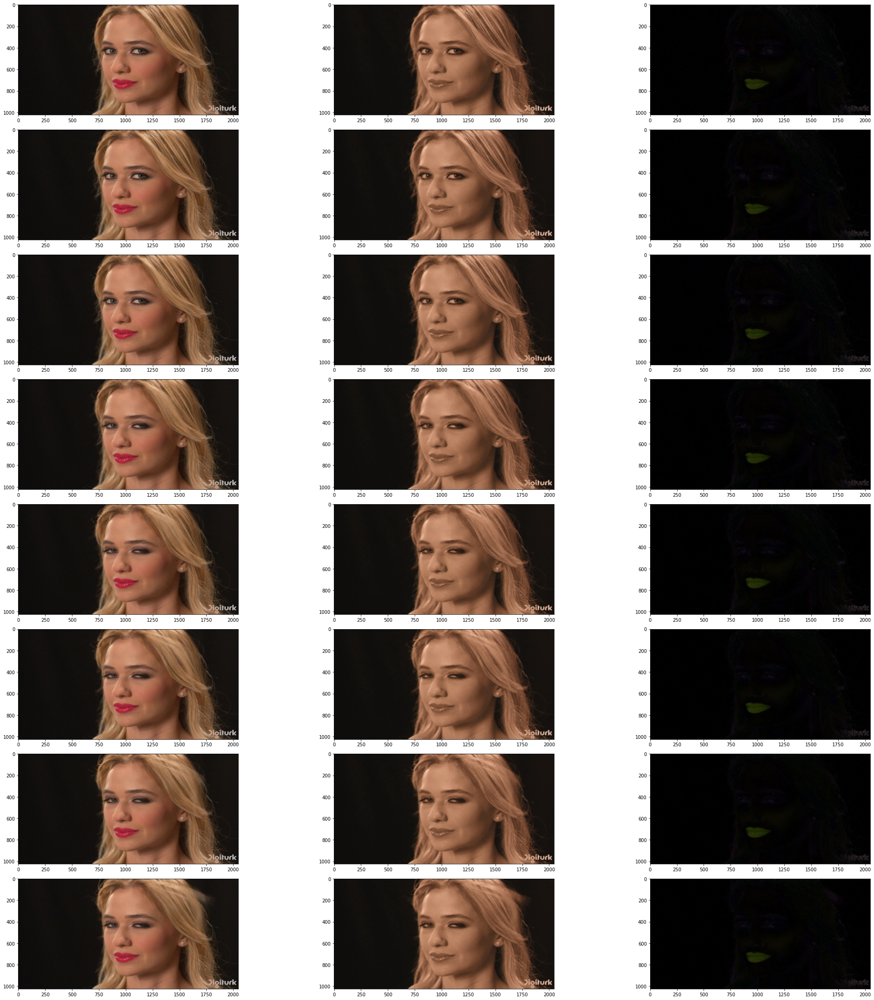

In [0]:
TrainAndPlot(Beauty, BuildClassicUnetModel, 2, 1000)